# Variable renewable energy profile processing and plotting

__*python=3.6*__

> Author: [tilseb](tilseb@dtu.dk)
>
> Created: 2018-05-23

### Search for TODO to continue!

## Content
- Script set-up
- Load data
- Read input files
- Format data frames
- Make directories
- Plot per commodity
- Plot per country

## Script set-up

In [84]:
# import required packages
import os
import re
import urllib.request
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [85]:
# make input and output directories
dirs = {'input', 'output/figs', 'output/data'}
for d in dirs:
    if not os.path.isdir(d):
        os.makedirs(d)

In [86]:
# make spp folder
if not os.path.isdir('output/figs/pv_production'):
    os.makedirs('output/figs/pv_production')

In [87]:
# make vwg folder
if not os.path.isdir('output/figs/wind_generation'):
    os.makedirs('output/figs/wind_generation')

In [88]:
# set plotting specifications
plt.rcParams.update({'font.size': 21})
plt.rcParams['xtick.major.pad']='12'
plt.rc('legend', fontsize=16)
y_limit = 1.1
lw = 3

## Download opsd data

In [89]:
# load latest time series data from opsd to local input folder if not already existing
t = '60min'  # ['15min', '30min']
tab = 'time_series_' + t +  '_singleindex.csv'
url = 'https://data.open-power-system-data.org/time_series/latest/'
targeturl = url + tab
localpath = 'input/opsd-' + tab

if os.path.isfile(localpath):
    print('Using local file.')
else:
    print('Downloading file from: ' + targeturl)
    urllib.request.urlretrieve(targeturl, localpath)

Using local file.


## Load auxilliary files

In [90]:
# load name dictionary
dn = pd.read_csv('input/name_dict.csv', encoding='utf8', index_col=0)

In [91]:
# make name dict from opsd_field_name to balmorel_name
dn = dn.iloc[:, 0].to_dict()

## Load data to data frames

In [92]:
# load latest time series data from opsd into pandas data frame
opsd = pd.read_csv(localpath, encoding='utf8', parse_dates=True, index_col=0)

In [93]:
# load the solar power production from Data.xlsm
spp = pd.read_excel('input/Data.xlsm',
                    sheet_name='43', header=11, skipfooter=8793, index_col=0)

In [94]:
# load the solar heat production from Data.xlsm
shp = pd.read_excel('input/Data.xlsm',
                    sheet_name='43', usecols='A:B', header=8801, skipfooter=3, index_col=0)

In [95]:
# load the solar power production from Data.xlsm
spp_old = pd.read_excel('input/Data_old.xlsm',
                        sheet_name='43', header=11, skipfooter=8793, index_col=0)

In [96]:
# load the variation of wind generation from Data.xlsm
vwg = pd.read_excel('input/Data.xlsm',
                    sheet_name='53', usecols='A:Y', header=13, skipfooter=21, index_col=0)

In [97]:
# load the old variation of wind generation from Data_old.xlsm
vwg_old = pd.read_excel('input/Data_old.xlsm',
                        sheet_name='53', usecols='A:Y', header=13, skipfooter=10, index_col=0)

## Data resolutions

In [98]:
# spatial resolution, set of all considered countries
ccc = {'DE'}

In [99]:
# temporal resolution, set of all considered years
yyy = {2012}

## Select OPSD data

In [100]:
# keep only considered years
for y in set(opsd.index.year) - yyy:
    opsd = opsd.loc[opsd.index.year!=y, :]

In [101]:
# delete 29th of February from leap years, if any exist
if opsd.index.is_leap_year.any():
    opsd = opsd.loc[~((opsd.index.month == 2) & (opsd.index.day == 29)), :]

In [102]:
# apply standard Balmorel time resolution by deleting surplus days: 52 weeks at 168 hours adding up to 365 days
opsd = opsd[opsd.index.dayofyear <= 365]

In [103]:
# select columns based on the keys of the name dictionary
vwg_opsd = opsd.reindex(columns=list(dn.values()))

In [104]:
# rename columns
vwg_opsd.columns = dn.keys()

In [105]:
# make function to filter by regex strings based on tokens
def mkrf(tokens):
    """ function that returns a regular expression (regex) string based on the given tokens
    input: list of tokens
    outout: regex filter string
    """
    base = r'^{}'
    expr = '(?=.*{})'
    return(base.format(''.join(expr.format(t) for t in tokens)))    

In [106]:
# read opsd wind capacity data to data frame based on tokens to be found in opsd column names
tokens = ['de', 'capacity', 'wind']
wcap_opsd = opsd.loc[:, opsd.columns.str.contains(mkrf(tokens), regex=True, flags=re.IGNORECASE)]

In [107]:
# make new column that tracks the additional onshore wind capacity installation throughout each year
wcap_opsd.loc[:, 'DE_wind_onshore_capacity_relative'] = wcap_opsd.DE_wind_onshore_capacity
wcap_opsd.loc[:, 'DE_wind_onshore_capacity_relative'] /= wcap_opsd.DE_wind_onshore_capacity.max()

C:\Users\tilseb\AppData\Local\Continuum\miniconda3\envs\plotting\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\tilseb\AppData\Local\Continuum\miniconda3\envs\plotting\lib\site-packages\pandas\core\indexing.py:576: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value


In [108]:
# # make new column that tracks the additional offshore wind capacity installation throughout each year
wcap_opsd.loc[:, 'DE_wind_offshore_capacity_relative'] = wcap_opsd.DE_wind_offshore_capacity
wcap_opsd.loc[:, 'DE_wind_offshore_capacity_relative'] /= wcap_opsd.DE_wind_offshore_capacity.max()

### Solar Power Production

In [109]:
# Make columns for seasons and terms
spp['season'] = spp.index.str.split('.').str[0]
spp['term'] = spp.index.str.split('.').str[1]

In [110]:
# divide each number of each countries columns by it's annual maximum 
for c in ccc:
    for i in spp[spp.columns[spp.columns.str.contains(c)==True]].columns:
        spp[i] /= spp[i].max()

In [111]:
# make columns for seasons and terms
spp_old['season'] = spp_old.index.str.split('.').str[0]
spp_old['term'] = spp_old.index.str.split('.').str[1]

In [112]:
# divide each number of each countries columns by it's annual maximum 
for c in ccc:
    for i in spp_old[spp_old.columns[spp_old.columns.str.contains(c)==True]].columns:
        spp_old[i] /= spp_old[i].max()

In [113]:
# make columns with country average
spp_old['DK'] = spp_old[spp_old.columns[spp_old.columns.str.contains('DK')==True]].sum(axis=1)
spp_old['DE'] = spp_old[spp_old.columns[spp_old.columns.str.contains('DE')==True]].sum(axis=1)

In [114]:
# Divide each number by each countries annual maximum
for c in ccc:
    spp_old[c] /= spp_old[c].max()

### Solar HeatProduction

In [115]:
# Make columns for seasons and terms
shp['season'] = shp.index.str.split('.').str[0]
shp['term'] = shp.index.str.split('.').str[1]

In [116]:
# Divide each number of each countries columns by it's annual maximum 
shp.DK2_Large /= shp.DK2_Large.max()

### Variation of Wind Generation

In [117]:
# make columns for seasons and terms
vwg['season'] = vwg.index.str.split('.').str[0]
vwg['term'] = vwg.index.str.split('.').str[1]

In [118]:
# Divide each row of each countries columns by its hourly percentage and annual maximum
# Values greater than 1 are reduced to 1
for c in ccc:
    for i in vwg_opsd.columns[vwg_opsd.columns.str.contains(c)==True]:
        if 'Offshore' in i:
            vwg[i] = (vwg_opsd[i] / wcap_opsd['DE_wind_offshore_capacity_relative'] / vwg_opsd[i].max()).values
            vwg[i] = np.where(vwg[i] > 1, 1, vwg[i])
        else:
            vwg[i] = (vwg_opsd[i] / wcap_opsd['DE_wind_onshore_capacity_relative'] / vwg_opsd[i].max()).values
            vwg[i] = np.where(vwg[i] > 1, 1, vwg[i])

In [119]:
# Shift the DE4-N profile 5 terms back and fill the last fife in a forward manner
vwg['adjust'] = vwg['DE4-N_A'].shift(-5).ffill()

# Calculate the difference between DE4-N and DE4-W_Offshore
diff = vwg['DE4-N_A'] - vwg['DE4-W_Offshore_A']

# Make an index for all differences greater than zero
idx = diff[diff>0].index

# Subtract the mean of the positive differences from the shifted DE4-N profile, where it occours
for i in idx:
    vwg.loc[i, 'DE4-W_Offshore_A'] = vwg.loc[i, 'adjust'] - diff[diff>0].mean()

# Convert all negative numerical entries to zero
num = vwg._get_numeric_data()
num[num < 0] = 0

In [120]:
# Round and write the resulting profiles to a csv file
output = vwg[['DE4-N_Offshore_A','DE4-W_Offshore_A']].round(3)
output.to_csv('output/data/DE4-Offshore_A.csv', encoding='utf8')

In [121]:
# Make columns for seasons and terms
vwg_old['season'] = vwg_old.index.str.split('.').str[0]
vwg_old['term'] = vwg_old.index.str.split('.').str[1]

In [122]:
# Divide each number of each countries columns by it's annual maximum 
for c in ccc:
    for i in vwg_old[vwg_old.columns[vwg_old.columns.str.contains(c)==True]].columns:
        vwg_old[i] /= vwg_old[i].max()

In [123]:
# Make columns with country sums
for c in ccc:
    vwg_old[c] = vwg_old[vwg_old.columns[vwg_old.columns.str.contains(c)==True]].sum(axis=1)

In [124]:
# Divide each number by each countries annual maximum
for c in ccc:
    vwg_old[c] /= vwg_old[c].max()

## Select Seasons

In [125]:
# Make a list of all seasons
sss = list(spp.season.unique())

In [126]:
# Seasons to investigate
# season_names = ['S01', 'S07', 'S20', 'S24', 'S28', 'S38', 'S42', 'S43']

In [127]:
# Make a list of every nth element of sss (1 <= nth <= 52)
nth = 1
s = sss[0::nth]

# Or select seasons by names
# s = season_names

## Select Terms

In [128]:
# Make a list of all Terms per season
ttt = list(spp.term.unique())

In [129]:
# Terms to investigate
# term_names = ['T005', 'T019', 'T033', 'T047', 'T061', 'T075', 'T089', 'T103', 'T117', 'T131', 'T145', 'T159']

In [130]:
# Make a list of every nth element of ttt (1 <= nth <= 168)
nth = 1
t = ttt[0::nth]

# Or select terms by name
# t = term_names

## Plotting

In [131]:
# Make data frames to plot
spp_plot = spp[(spp.season.isin(s)) & (spp.term.isin(t))]
shp_plot = shp[(shp.season.isin(s)) & (shp.term.isin(t))]
vwg_plot = vwg[(vwg.season.isin(s)) & (vwg.term.isin(t))]

In [132]:
# Set indices to terms
spp_plot.set_index('term', inplace=True)
shp_plot.set_index('term', inplace=True)
vwg_plot.set_index('term', inplace=True)

In [133]:
# Make data frames to plot
spp_old_plot = spp_old[(spp_old.season.isin(s)) & (spp_old.term.isin(t))]
vwg_old_plot = vwg_old[(vwg_old.season.isin(s)) & (vwg_old.term.isin(t))]

In [134]:
# Set indices to terms
spp_old_plot.set_index('term', inplace=True)
vwg_old_plot.set_index('term', inplace=True)

In [135]:
# Create vertical bars per step
steps = 24
t_selected = spp_plot.index.unique()[0::steps]
t_marker = np.arange(0, len(t), steps)

# Or mark selected terms
# t_selected = term_names
# t_marker = np.arange(0, len(t), steps)

## Save data to csv

In [136]:
spp_plot.to_csv('output/data/Data_spp_new.csv', encoding='utf8')

In [137]:
shp_plot.to_csv('output/data/Data_shp_new.csv', encoding='utf8')

In [138]:
vwg_plot.to_csv('output/data/Data_vwg_new.csv', encoding='utf8')

### Plot per Commodity 

#### Solar Power Production

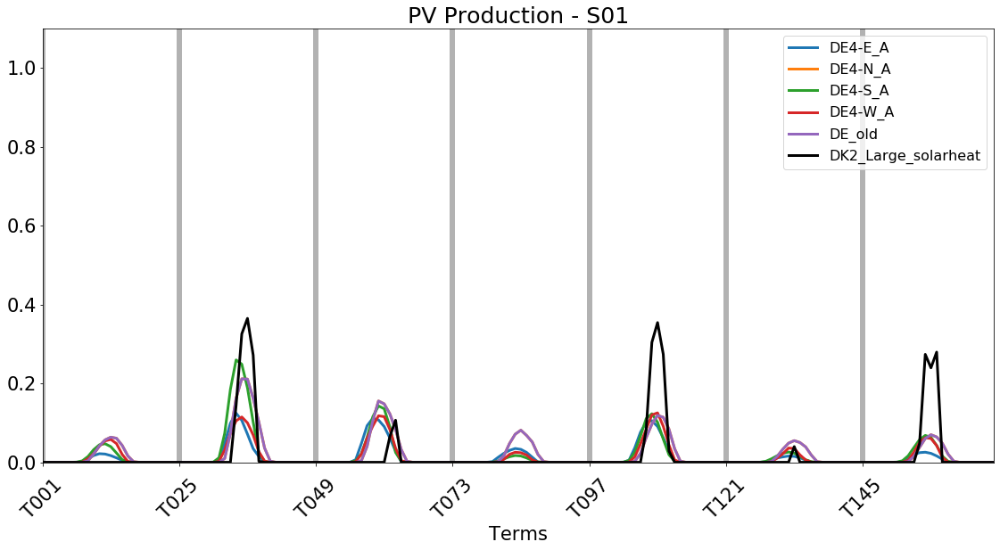

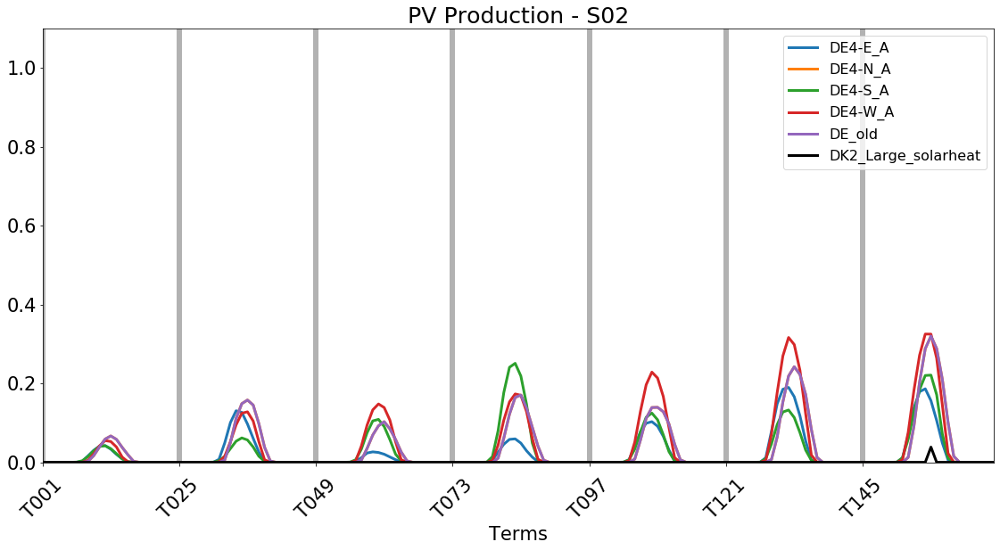

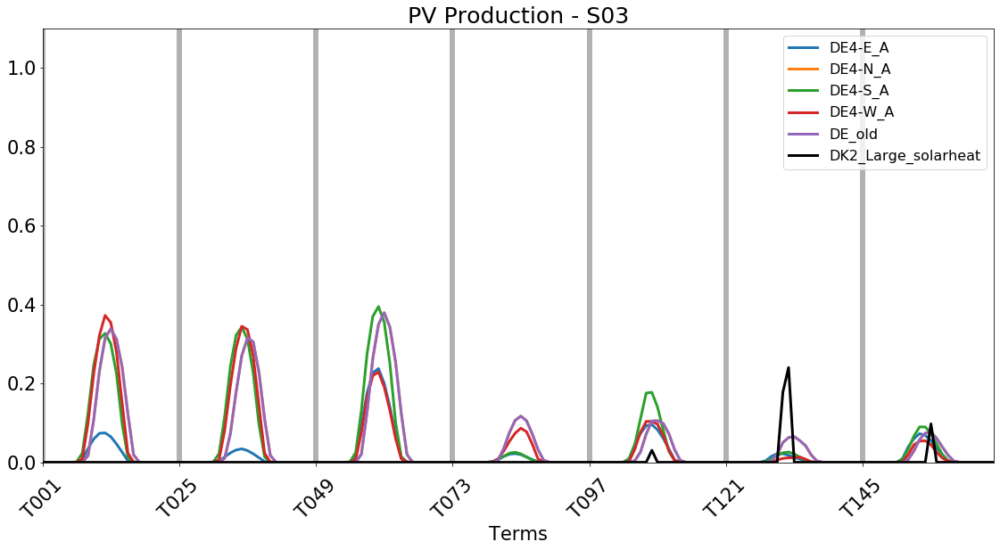

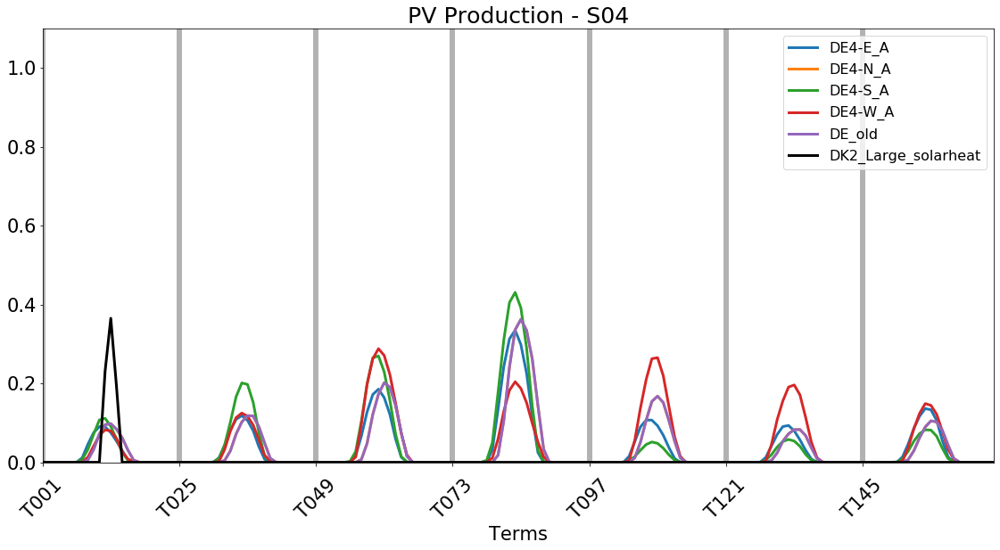

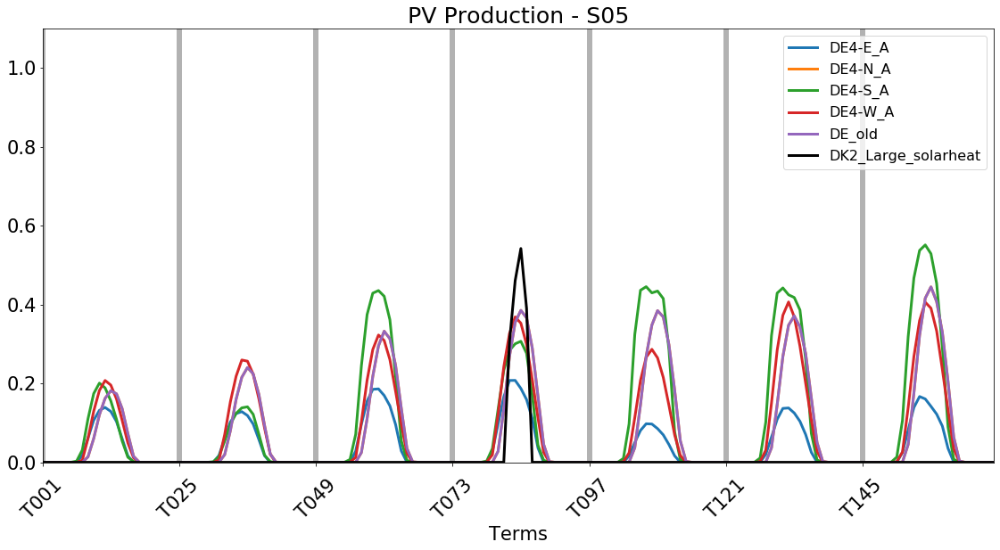

...

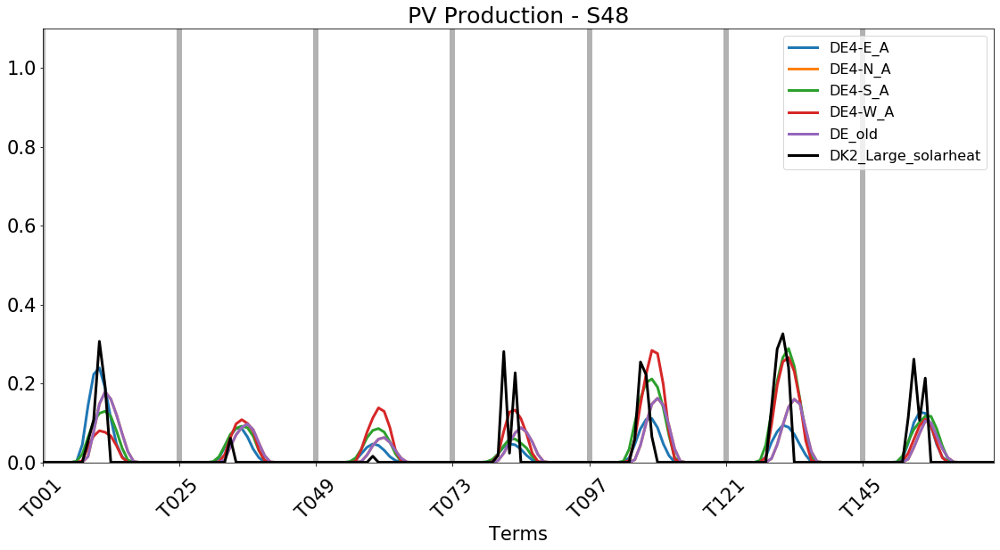

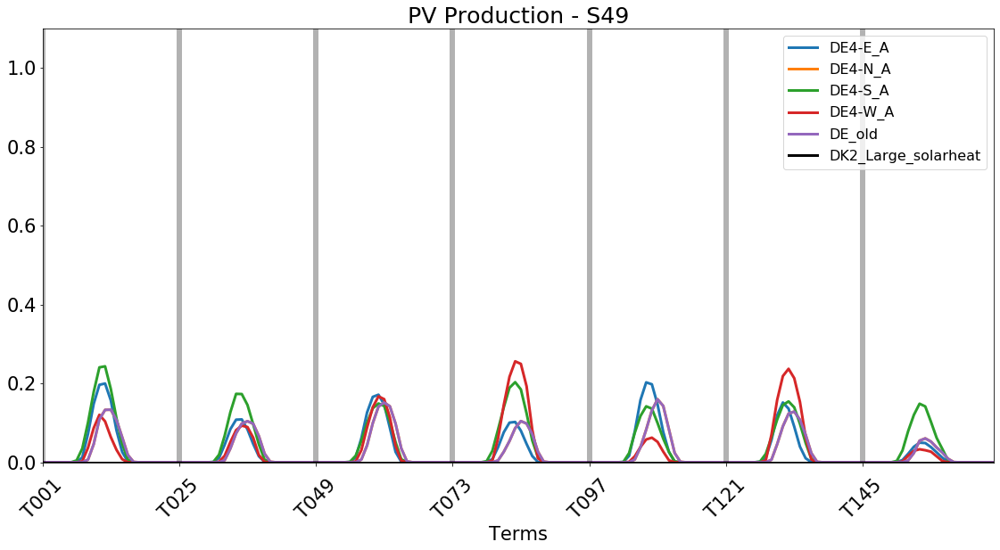

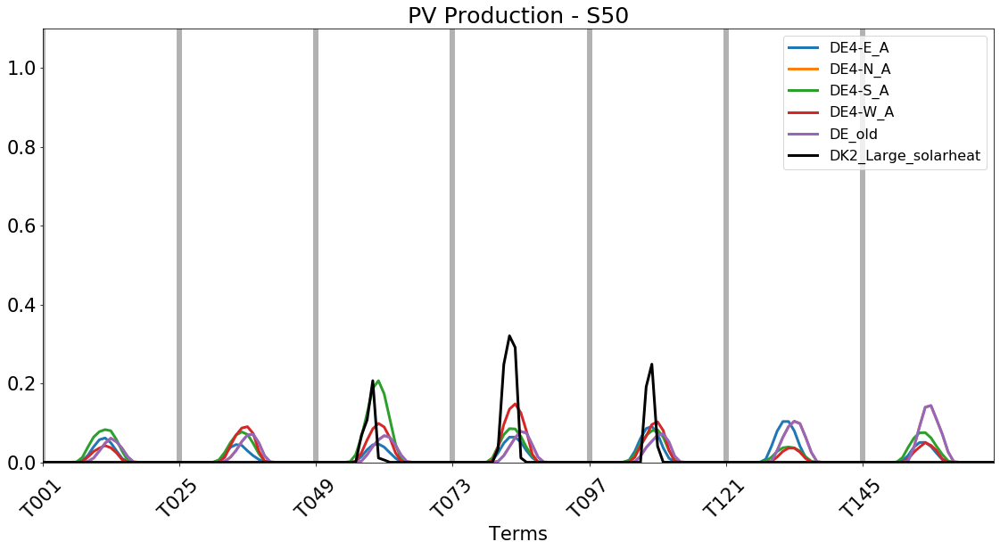

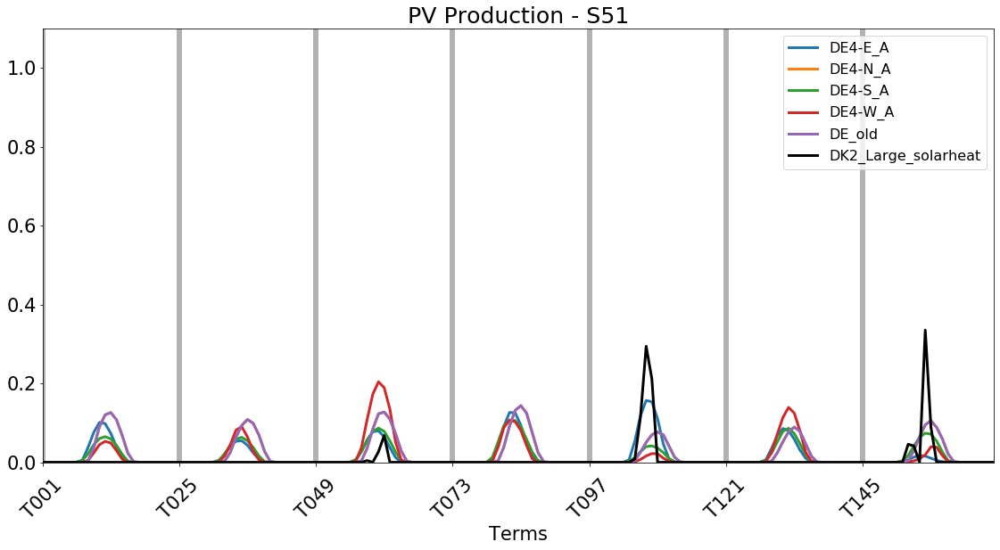

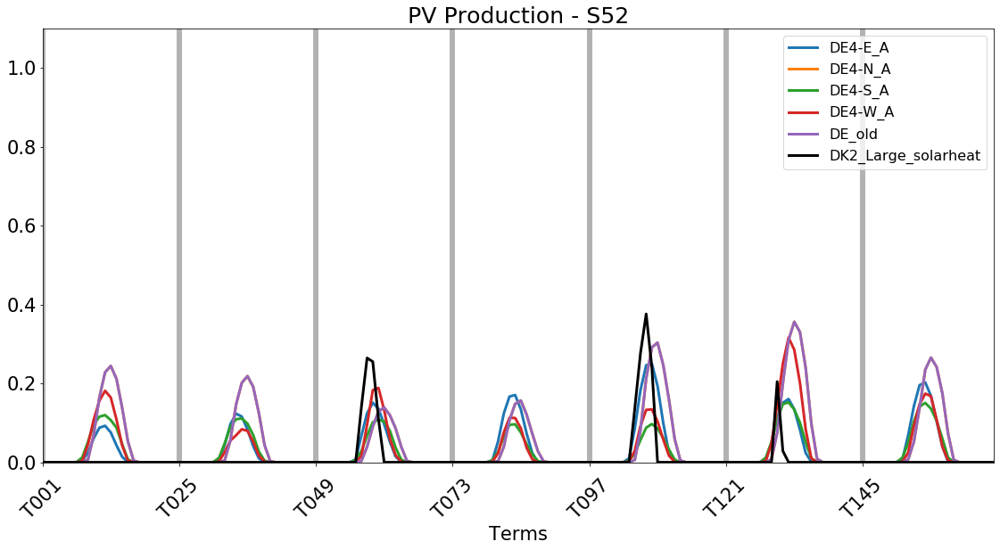

In [139]:
for i in s:
    x = spp_plot[spp_plot.season.isin([i])][spp_plot.columns[spp_plot.columns.str.contains('DE')]].plot(figsize=(16,9), lw=lw)
    spp_old_plot[spp_old_plot.season.isin([i])]['DE'].plot(x=x, figsize=(16,9), lw=lw, label='DE_old')
    shp_plot[shp_plot.season.isin([i])]['DK2_Large'].plot(x=x, figsize=(16,9), lw=lw, c='black', label='DK2_Large_solarheat')
    plt.ylim([0, y_limit])
    plt.legend(loc=1)
    plt.title('PV Production' + ' - ' + i)
    plt.xlabel('Terms')
    plt.xticks(t_marker, t_selected, rotation=45)
    for x_pos in t_marker:
        plt.axvline(x=x_pos, c='black', lw=6, alpha=0.3)
    plt.tight_layout()
    plt.savefig('output/figs/pv_production/spp_' + i + '.png', compression=None)
    plt.show()
    plt.close()
plt.close()

#### Variation of Wind Generation

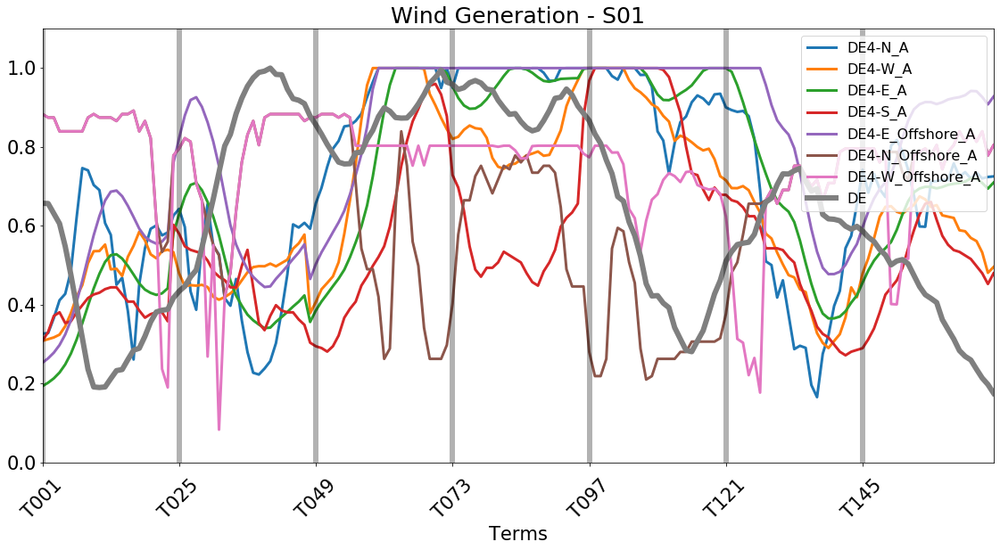

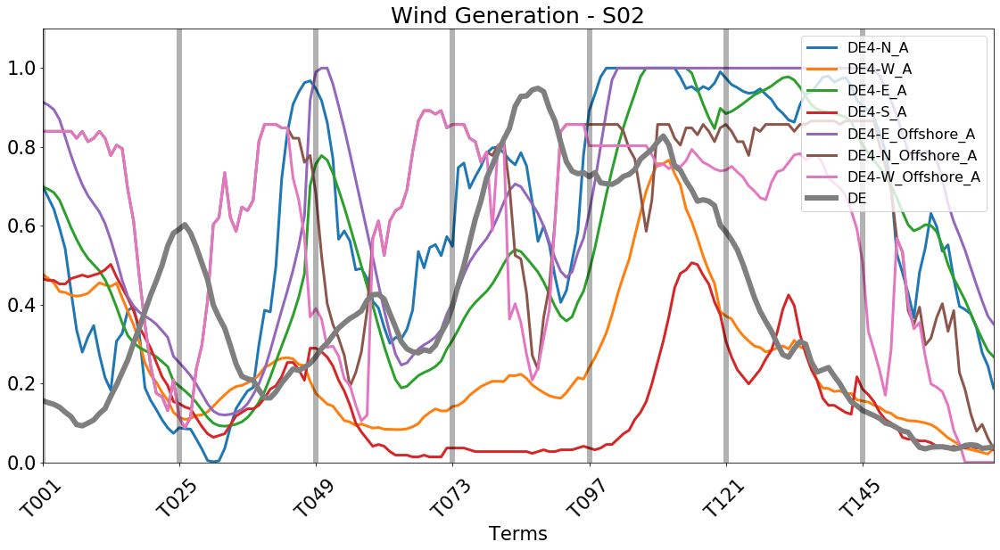

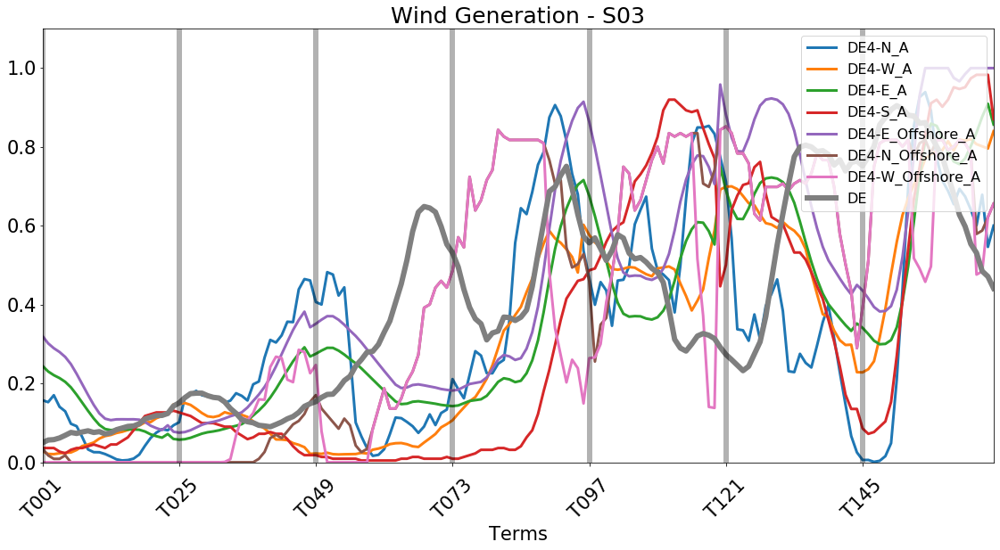

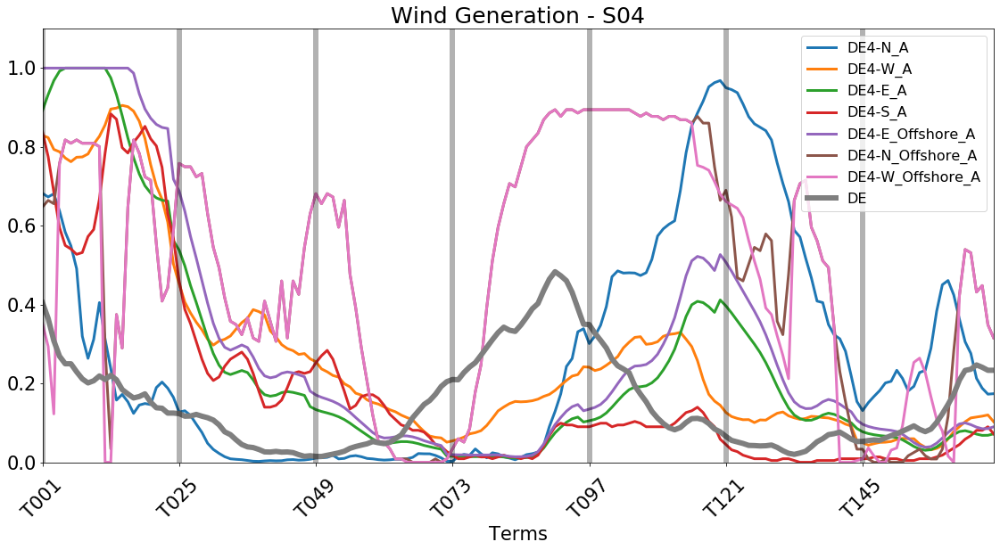

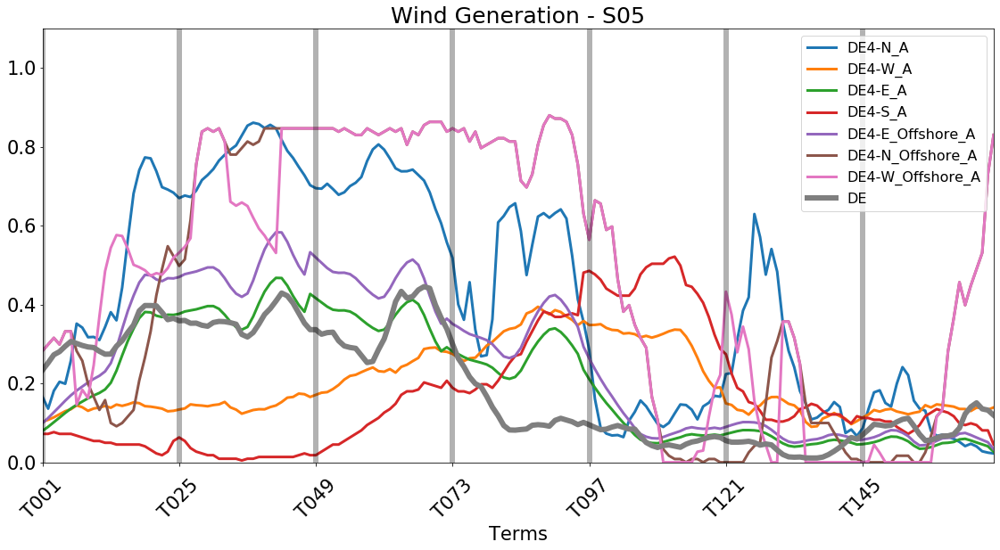

...

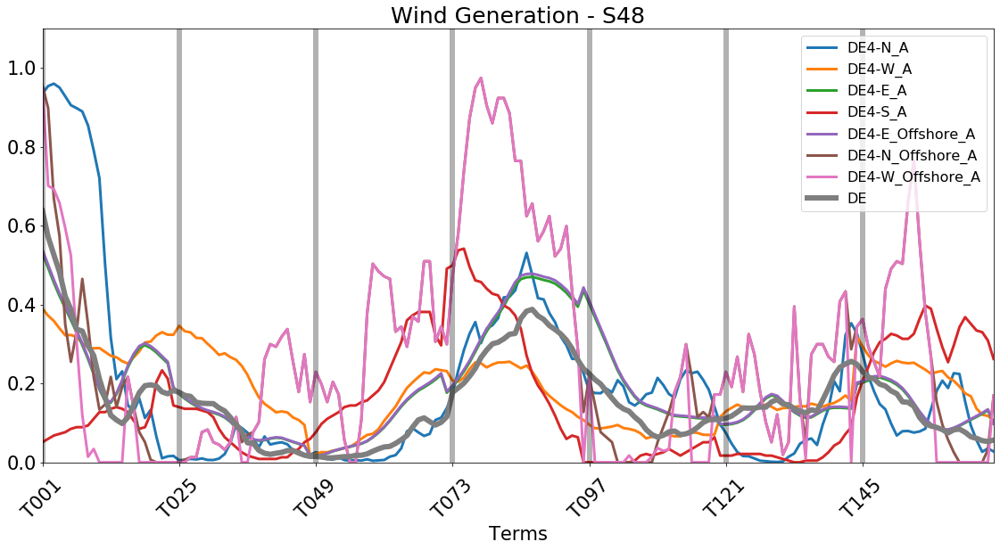

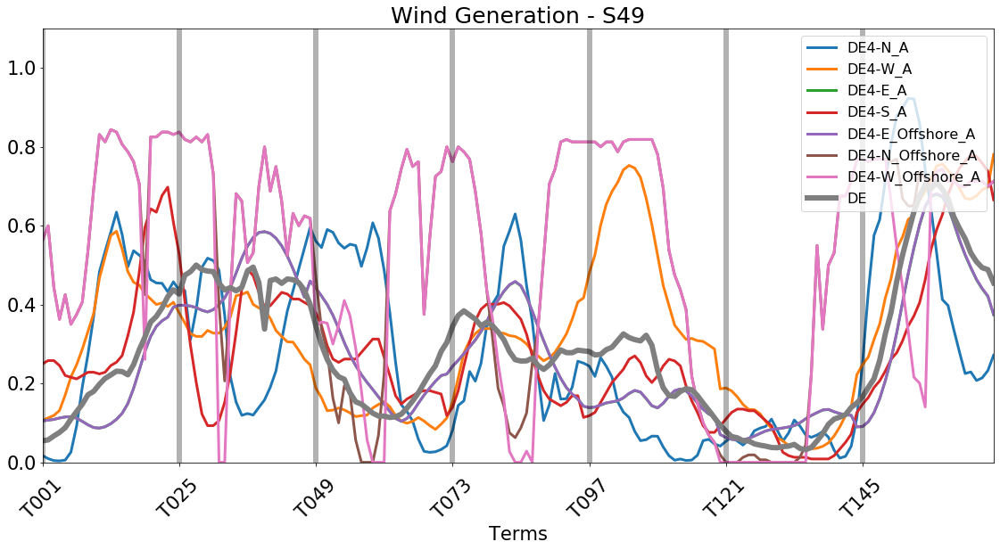

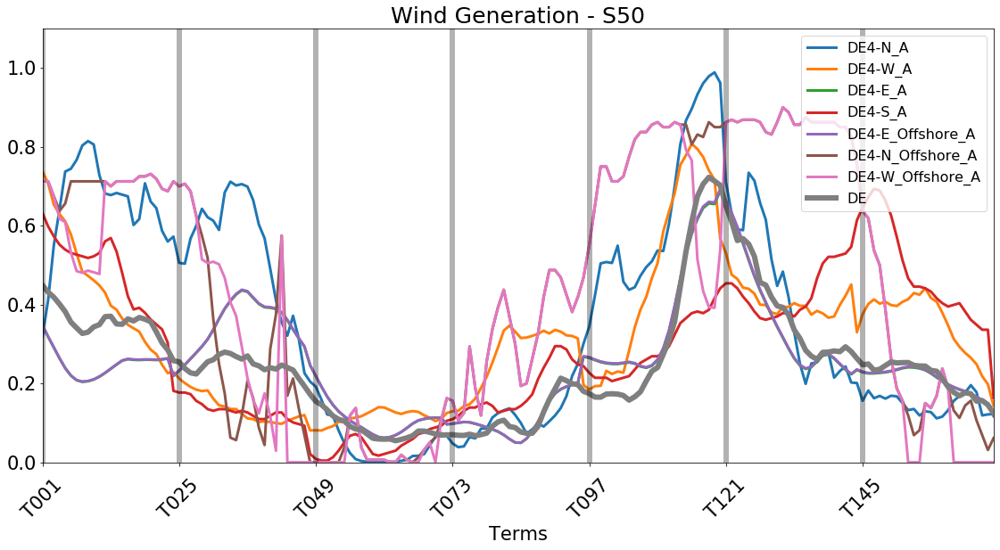

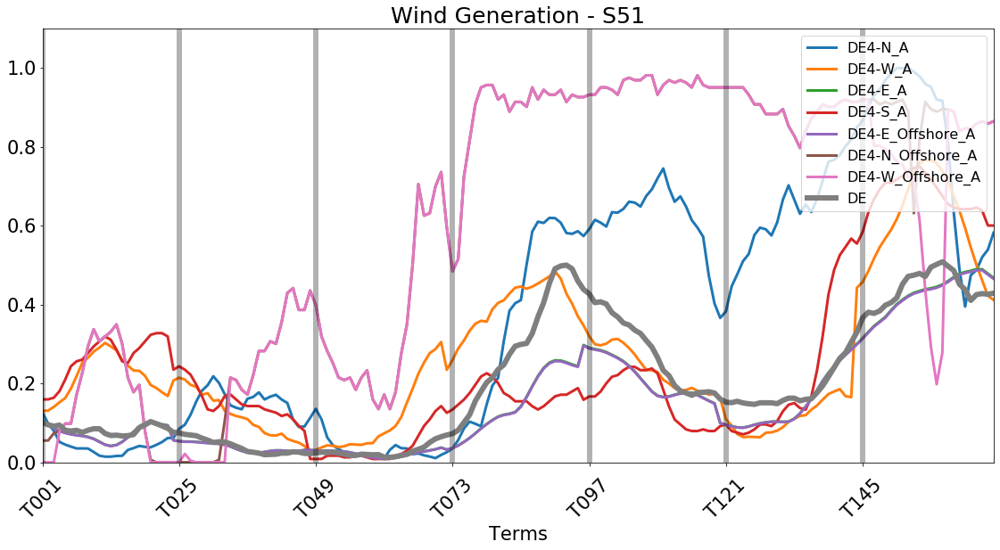

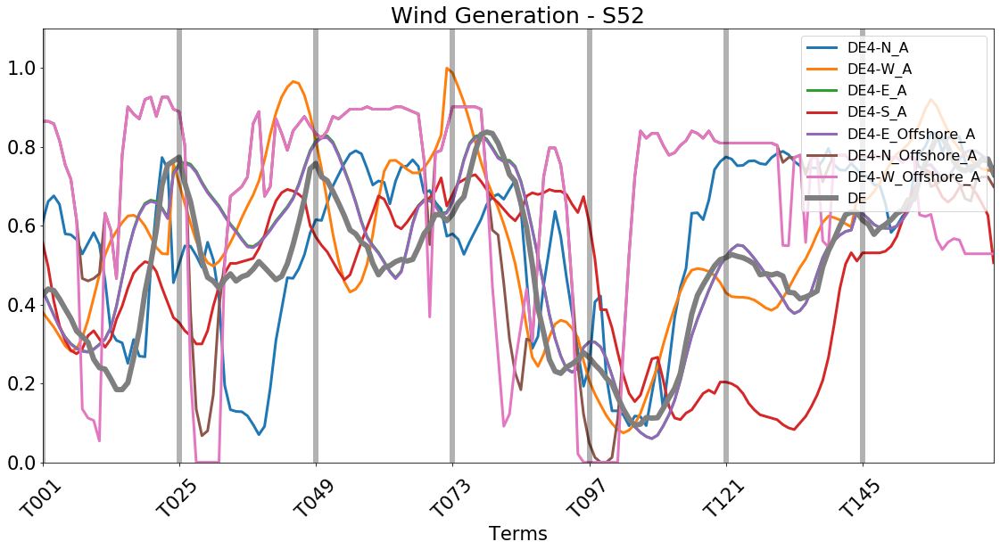

In [140]:
for i in s:
    x = vwg_plot[vwg_plot.season.isin([i])][vwg_plot.columns[vwg_plot.columns.str.contains('DE')]].plot(figsize=(16,9), lw=lw)
    vwg_old_plot[vwg_old_plot.season.isin([i])]['DE'].plot(x=x, figsize=(16,9), lw=lw*2)
    plt.ylim([0, y_limit])
    plt.legend(loc=1)
    plt.title('Wind Generation' + ' - ' + i)
    plt.xlabel('Terms')
    plt.xticks(t_marker, t_selected, rotation=45)
    for x_pos in t_marker:
        plt.axvline(x=x_pos, c='black', lw=6, alpha=0.3)
    plt.tight_layout()
    plt.savefig('output/figs/wind_generation/vwg_' + i + '.png', compression=None)
    plt.show()
    plt.close()
plt.close()